In [1]:
import cv2
import numpy as np
from skimage import io

from matplotlib import pyplot as plt

In [2]:
def cv2_imshow(img):
    plt.rcParams['figure.figsize'] = [20, 20]
    plt.imshow(img, cmap = 'gray', interpolation = 'bicubic')
    plt.axis("off")
    plt.show()
    
def rotate90(img):
    # flip image vertically
    img = cv2.flip(img, 0)
    # transpose image
    img = cv2.transpose(img)
    
    return img

def url_to_image(url):
    print("downloading %s" % (url))
    return cv2.cvtColor(io.imread(url), cv2.COLOR_BGR2RGB)

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/images/bookpage1.jpg


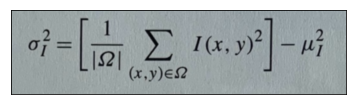

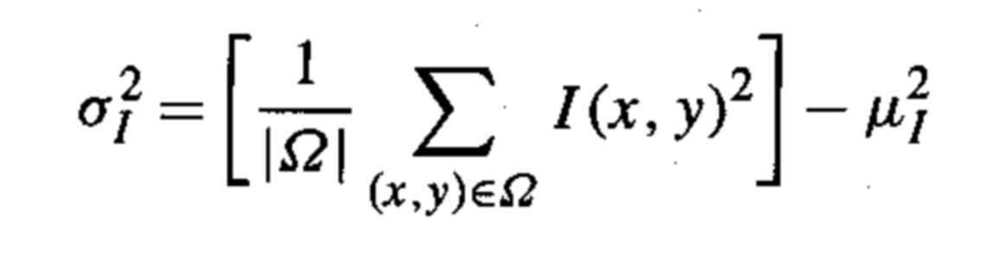

In [3]:
url = "https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/images/bookpage1.jpg"
img = url_to_image(url)
grayscaled = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)

plt.imshow(img, cmap = 'gray', interpolation = 'bicubic')
plt.xticks([]), plt.yticks([])
plt.show()

imgray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
ret, thresh = cv2.threshold(imgray, 127, 255, 0)
cv2_imshow(thresh)

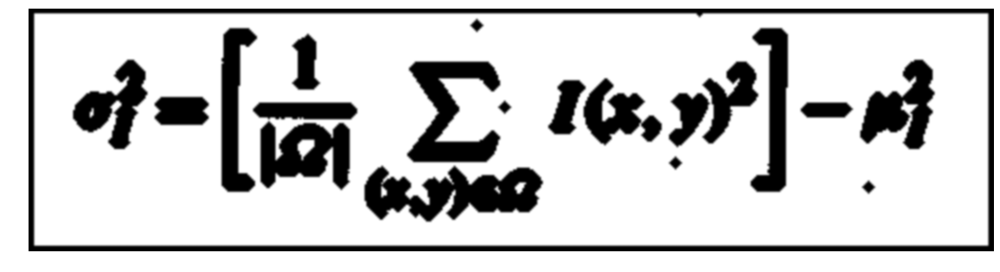

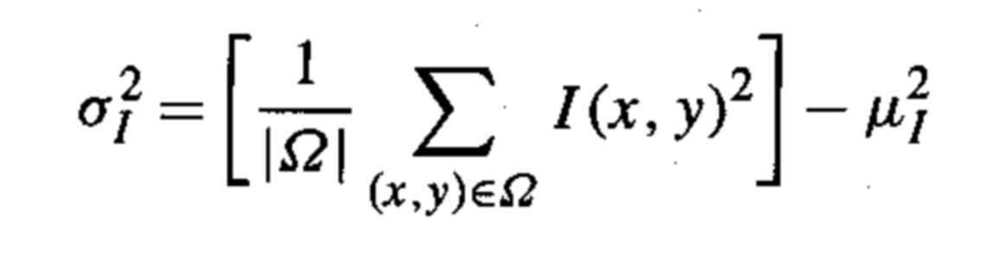

In [4]:
contours, i = cv2.findContours(thresh.copy(), cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

countour_img = thresh.copy()
cv2.drawContours(countour_img, contours, -1, (0,255,0), 3)
cv2_imshow(countour_img)

cv2_imshow(thresh)

## Text detection experiments

### OpenCV CNN 

pip install opencv-contrib-python

https://github.com/MhLiao/TextBoxes


https://docs.opencv.org/3.4/d1/d66/classcv_1_1text_1_1TextDetectorCNN.html#details

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text1.jpg
[ 29 147 149  32]
[ 41 186  88  30]
[127 186 133  29]
[159 146 145  29]


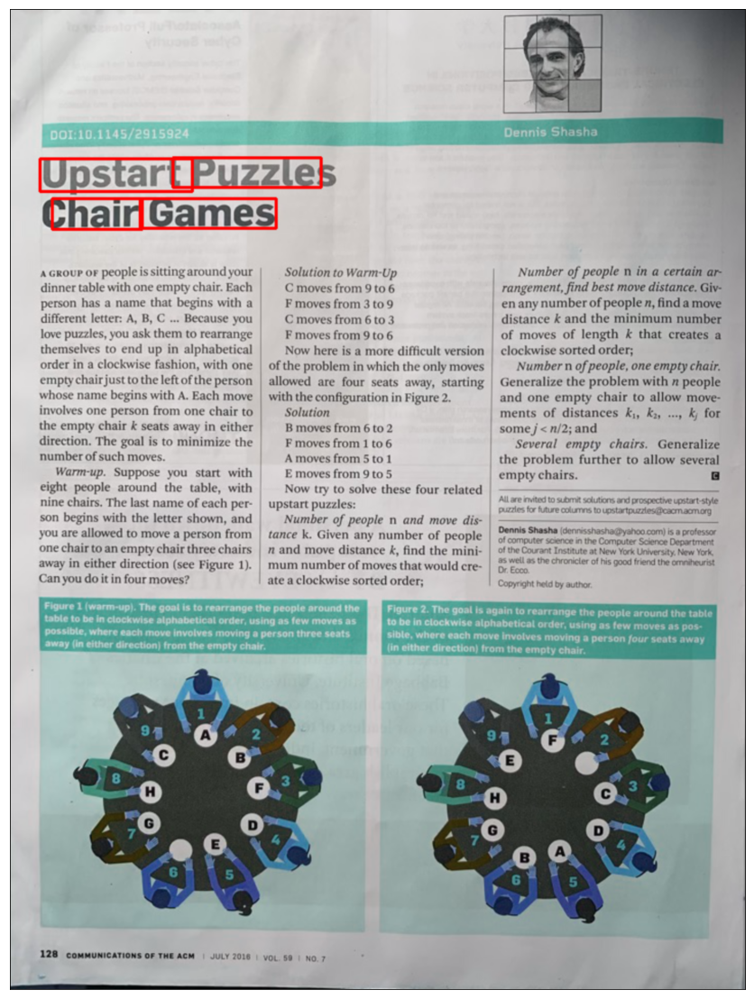

True

In [5]:
img = url_to_image('https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text1.jpg')
img = rotate90(img)

textSpotter = cv2.text.TextDetectorCNN_create("textbox.proto", "TextBoxes_icdar13.caffemodel")
rects, outProbs = textSpotter.detect(img);
vis = img.copy()
thres = 0.1

for r in range(np.shape(rects)[0]):
    if outProbs[r] > thres:
        print(rects[r])
        rect = rects[r]
        cv2.rectangle(vis, (rect[0],rect[1]), (rect[0] + rect[2], rect[1] + rect[3]), (255, 0, 0), 2)

plt.imshow(vis, cmap = 'gray', interpolation = 'bicubic')
plt.xticks([]), plt.yticks([])
plt.show()

cv2.imwrite('text.png',vis)

### Google tesseract

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text1.jpg


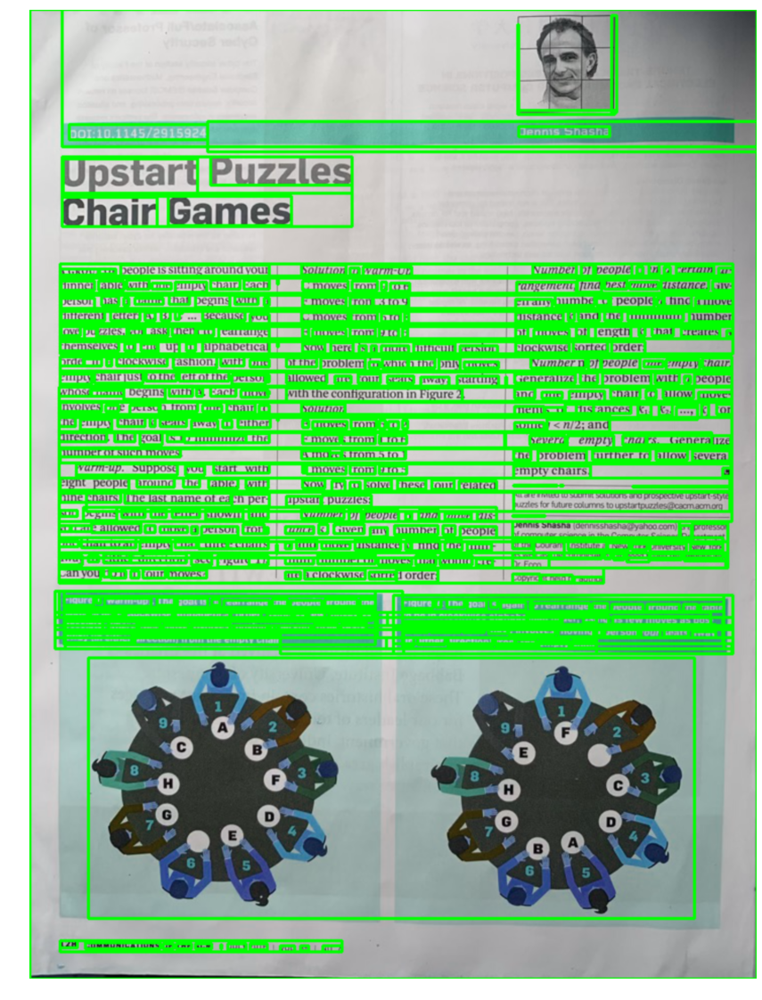

In [6]:
# brew intall pytesseract
import pytesseract
from pytesseract import Output

img = url_to_image('https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text1.jpg')
img = rotate90(img)

d = pytesseract.image_to_data(img, output_type=Output.DICT)
n_boxes = len(d['level'])
for i in range(n_boxes):
    (x, y, w, h) = (d['left'][i], d['top'][i], d['width'][i], d['height'][i])
    cv2.rectangle(img, (x, y), (x + w, y + h), (0, 255, 0), 2)
    
cv2_imshow(img)

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text1.jpg


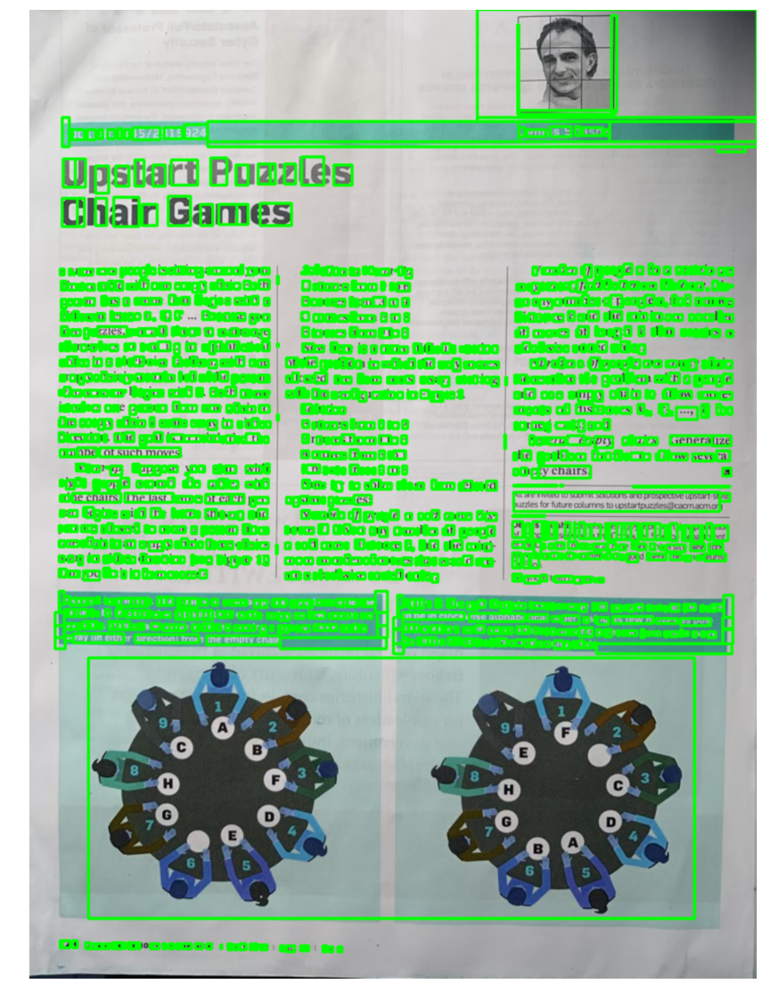

In [7]:
img = url_to_image('https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text1.jpg')
img = rotate90(img)

h, w, _ = img.shape # assumes color image
boxes = pytesseract.image_to_boxes(img)

# draw the bounding boxes on the image
rectangles = []
for b in boxes.splitlines():
    b = b.split(' ')
    rectangle = [int(b[1]), h - int(b[2]), int(b[3]), h - int(b[4])]
    cv2.rectangle(img, (rectangle[0], rectangle[1]), (rectangle[2], rectangle[3]), (0, 255, 0), 2)
    rectangles.append(rectangle)
    #cv2.rectangle(img, (int(b[1]), h - int(b[2])), (int(b[3]), h - int(b[4])), (0, 255, 0), 2)
    
cv2_imshow(img)

[[1, 2, 3, 4], [1, 2, 3, 4], [4, 5, 6, 7], [4, 5, 6, 7]]
(array([[1, 2, 3, 4],
       [4, 5, 6, 7]], dtype=int32), array([[2],
       [2]], dtype=int32))
downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text1.jpg
1939
2


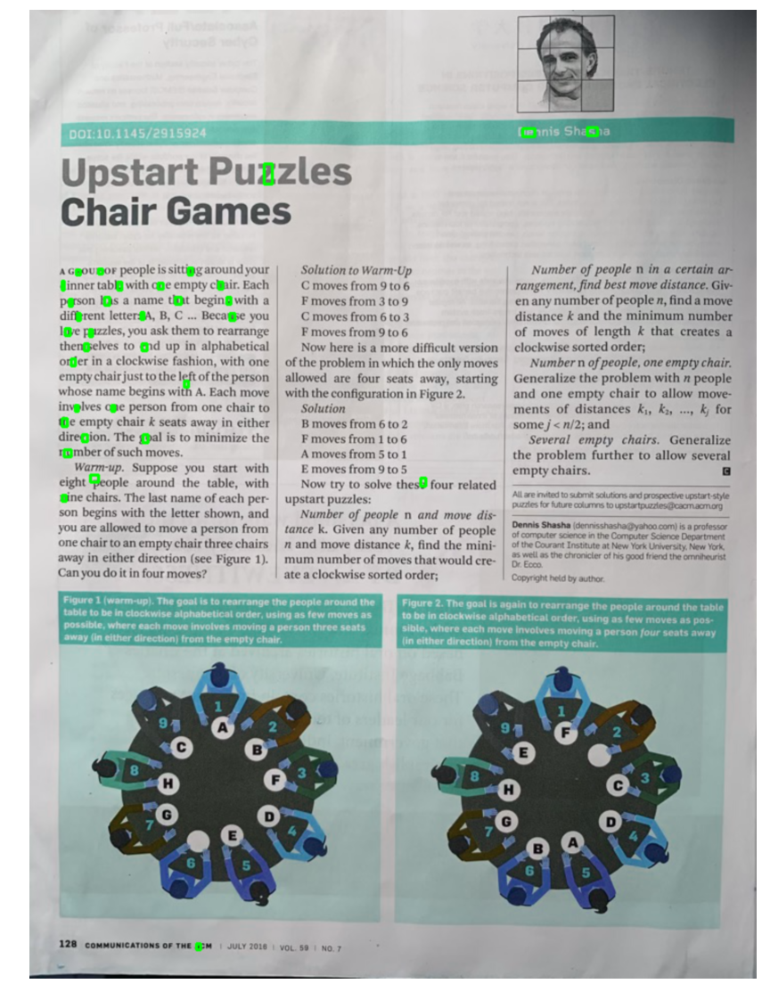

In [8]:
a = [[1,2,3,4],[1,2,3,4],[4,5,6,7],[4,5,6,7]]
print(a)
print(cv2.groupRectangles(a,1,0))

img = url_to_image('https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text1.jpg')
img = rotate90(img)

print(len(rectangles))
rectangles_merged = cv2.groupRectangles(rectangles,1,0.1)
print(len(rectangles_merged))

# draw the bounding boxes on the image
for rectangle in rectangles_merged[0]:
    cv2.rectangle(img, (rectangle[0], rectangle[1]), (rectangle[2], rectangle[3]), (0, 255, 0), 2)
    
cv2_imshow(img)

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text1.jpg


/anaconda3/lib/python3.7/site-packages/sympy/geometry/polygon.py:869: UserWarning: Polygons may intersect producing erroneous output
  warnings.warn("Polygons may intersect producing erroneous output")


10.0
[[  1   1]
 [700  20]
 [ 30  30]
 [400 400]]
(1, 1, 700, 400)
0


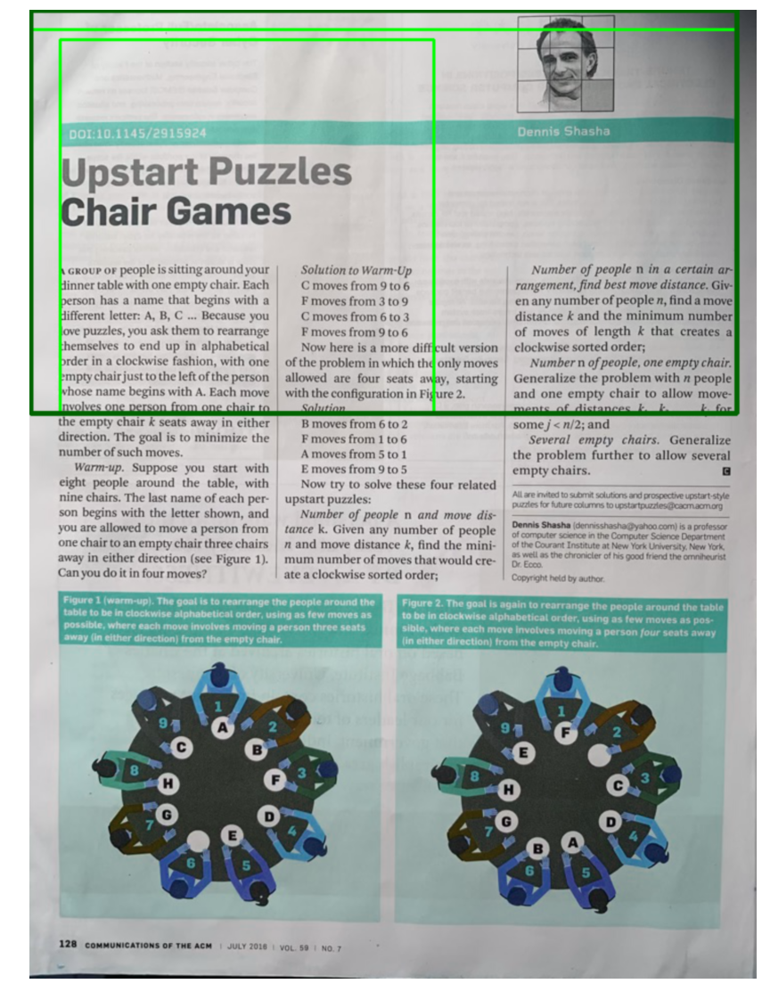

In [9]:
# https://docs.opencv.org/3.1.0/dd/d49/tutorial_py_contour_features.html

from sympy import Polygon

img = url_to_image('https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text1.jpg')
img = rotate90(img)

def get_distance(rec1, rec2):
    #print(rec2)
    #print((rec2[0], rec2[1]), (rec2[0], rec2[3]), (rec2[2], rec2[3]), (rec2[2], rec2[1]))
    
    p1 = Polygon((rec1[0], rec1[1]), (rec1[0], rec1[3]), (rec1[2], rec1[3]), (rec1[2], rec1[1]))
    p2 = Polygon((rec2[0], rec2[1]), (rec2[0], rec2[3]), (rec2[2], rec2[3]), (rec2[2], rec2[1]))
    
    if p1.intersection(p2):
        return 0
    
    if p1.encloses_point((rec2[0], rec2[1])) or p1.encloses_point((rec2[0], rec2[3])) or p1.encloses_point((rec2[2], rec2[3])) or p1.encloses_point((rec2[2], rec2[1])):
        return 0
    
    if p2.encloses_point((rec1[0], rec1[1])) or p2.encloses_point((rec1[0], rec1[3])) or p2.encloses_point((rec1[2], rec1[3])) or p2.encloses_point((rec1[2], rec1[1])):
        return 0

    return float(p1.distance(p2))

rec1 = [1,1,700,20]
rec2 = [30,30,400,400]

print(get_distance(rec1, rec2))

cv2.rectangle(img, (rec1[0], rec1[1]), (rec1[2], rec1[3]), (0, 255, 0), 2)
cv2.rectangle(img, (rec2[0], rec2[1]), (rec2[2], rec2[3]), (0, 255, 0), 2)

box = cv2.boundingRect(np.asarray([rec1, rec2]).flatten().reshape(4,2))
print(np.asarray([rec1, rec2]).flatten().reshape(4,2)) 

print(box)
print(get_distance([20,20,25,25], box))

cv2.rectangle(img, (box[0], box[1]), (box[2], box[3]), (0, 100, 0), 4)
cv2_imshow(img)

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text1.jpg
1939
2


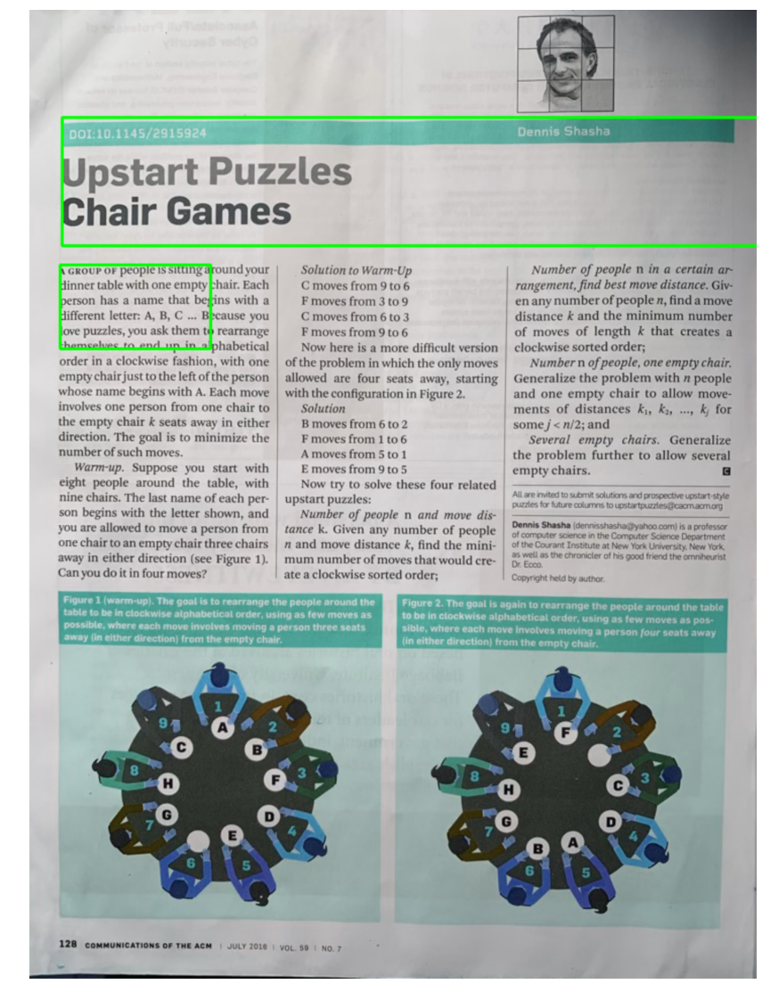

In [10]:
img = url_to_image('https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text1.jpg')
img = rotate90(img)

rectangles_merged = []

# take second element for sort
def sort_by_hypot(elem):
    return min(np.hypot(elem[0],elem[1]), np.hypot(elem[2],elem[3]))
rectangles.sort(key=sort_by_hypot)

# draw the bounding boxes on the image
for rectangle in rectangles[0:100]:
    merged = False
    for idx, rectangle_merged in enumerate(rectangles_merged):
        if get_distance(rectangle, rectangle_merged)<10:
            # merge
            rec = cv2.boundingRect(np.asarray([rectangle, rectangle_merged]).flatten().reshape(4,2))
            rectangles_merged[idx] = [rec[0], rec[1], rec[0]+rec[2], rec[1]+rec[3]] 
            merged = True  
            break
            
    if not merged:
        # create new structure
        rectangles_merged.append(rectangle)

print(len(rectangles))
print(len(rectangles_merged))
            
for rectangle in rectangles_merged:
    cv2.rectangle(img, (rectangle[0], rectangle[1]), (rectangle[2], rectangle[3]), (0, 255, 0), 2)        

cv2_imshow(img)

### 1. Separate text from background

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text6.jpg


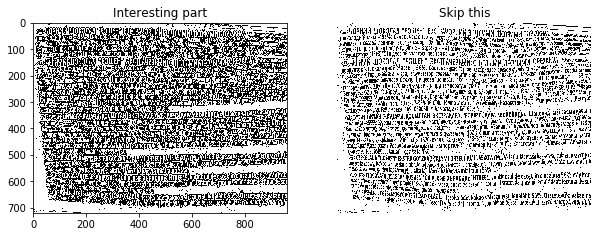

7106 6382
5986 6375


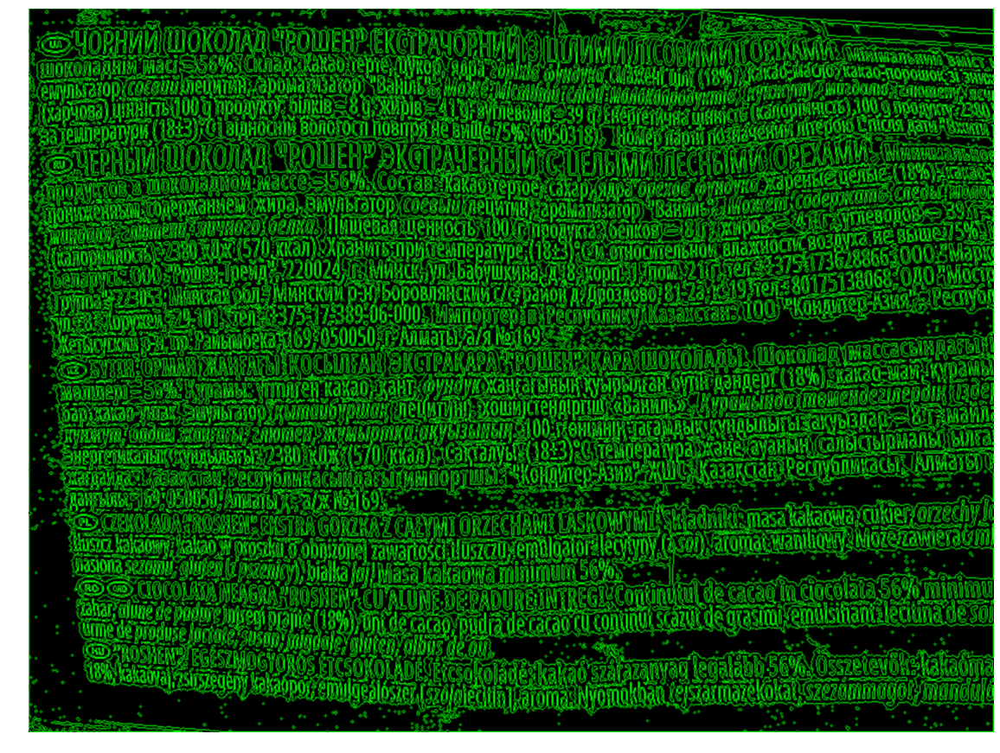

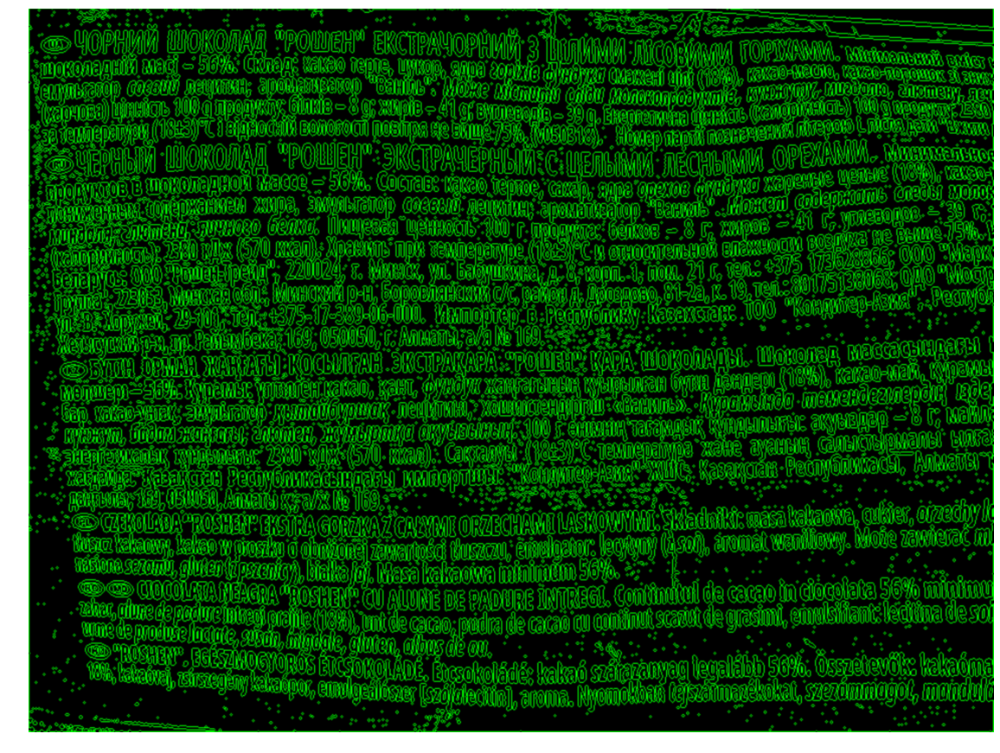

205716 165634
383084 516941


array([[255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       ...,
       [  0,   0,   0, ..., 255, 255, 255],
       [255, 255,   0, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255]], dtype=uint8)

In [11]:
def simple_pipline(gray):
    thresh = test_color_of_text(gray)
    
    #blur = cv2.GaussianBlur(gray,(5,5),0)
    #ret, thresh = cv2.threshold(blur,5,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
    denoised = cv2.fastNlMeansDenoising(thresh,None, 60, 5, 5)
    
    return denoised

# Decide what is the color of text and background. Make text black and background white.
def test_color_of_text(gray, debug = False):
    thresh1 = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 6)
    thresh2 = cv2.adaptiveThreshold(255-gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 6)

    if debug:
        plt.rcParams['figure.figsize'] = [10, 10]
        plt.subplot(121),plt.imshow(thresh1,cmap = 'gray')
        plt.title('Interesting part')
        plt.subplot(122),plt.imshow(thresh2,cmap = 'gray')
        plt.title('Skip this'), plt.axis("off")
        plt.show()
    
    contours1, hierarchy1 = cv2.findContours(thresh1, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)
    contours2, hierarchy2 = cv2.findContours(thresh2, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)     
    
    if debug:
        print(len(contours1),len(contours2))
    
    c1 = 0
    for i in hierarchy1[0]:
        if i[2] == -1:
            c1 +=1

    c2 = 0
    for i in hierarchy2[0]:
        if i[2] == -1:
            c2 +=1
    if debug:
        print(c1, c2)
    
    contours, hierarchy = cv2.findContours(thresh1, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    countour_img1 = np.full_like(img, 0)
    cv2.drawContours(countour_img1, contours, -1, (0,255,0), 1)
    if debug:
        cv2_imshow(countour_img1)
    
    contours, hierarchy = cv2.findContours(thresh2, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    countour_img2 = np.full_like(img, 0)
    cv2.drawContours(countour_img2, contours, -1, (0,255,0), 1)
    if debug:
        cv2_imshow(countour_img2)
    
    if debug:
        print(np.count_nonzero(countour_img1), np.count_nonzero(countour_img2))
        print(np.count_nonzero(thresh1), np.count_nonzero(thresh2))
    
    if np.count_nonzero(thresh1) > np.count_nonzero(thresh2):
        return thresh1
    else:
        return thresh2

img = url_to_image('https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text6.jpg')
gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
test_color_of_text(gray, True)

# img = url_to_image('https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text5.jpg')
# img = rotate90(img)
# gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
# test_color_of_text(gray)

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text1.jpg


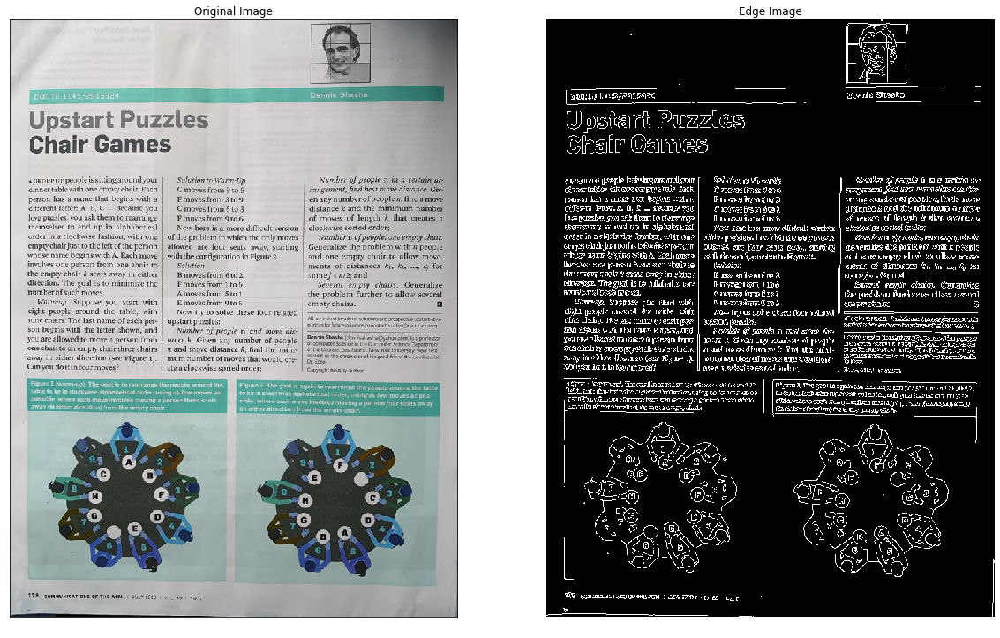

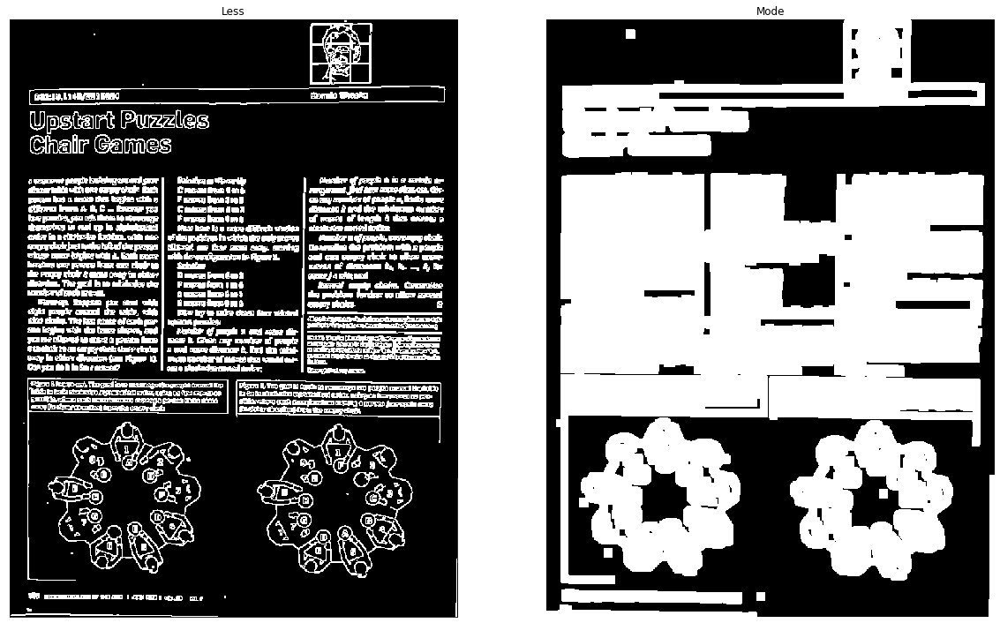

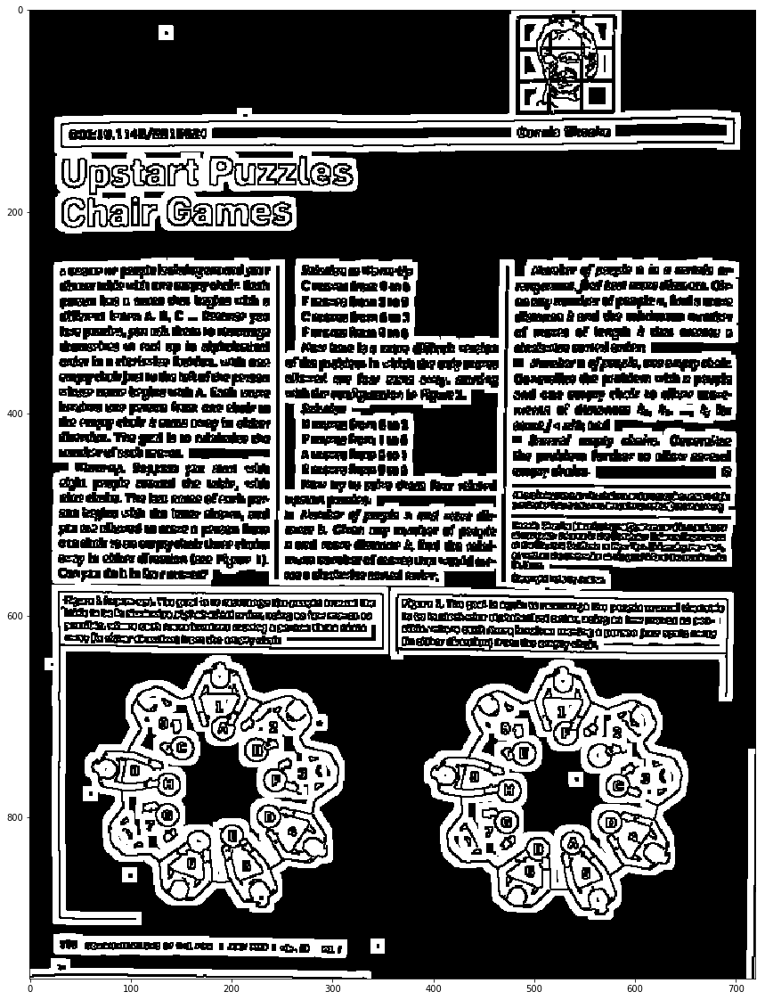

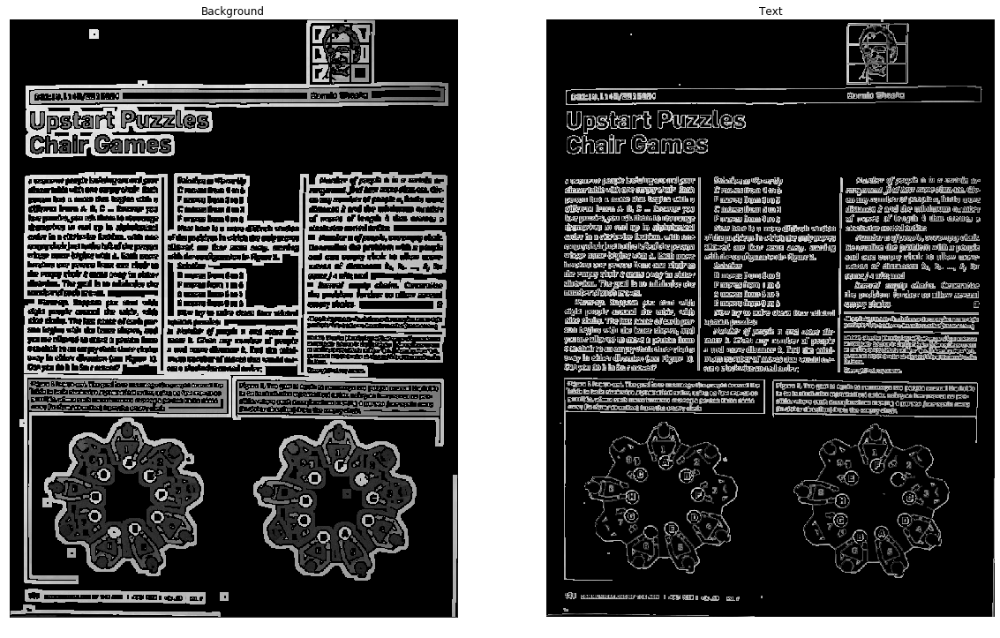

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text2.jpg


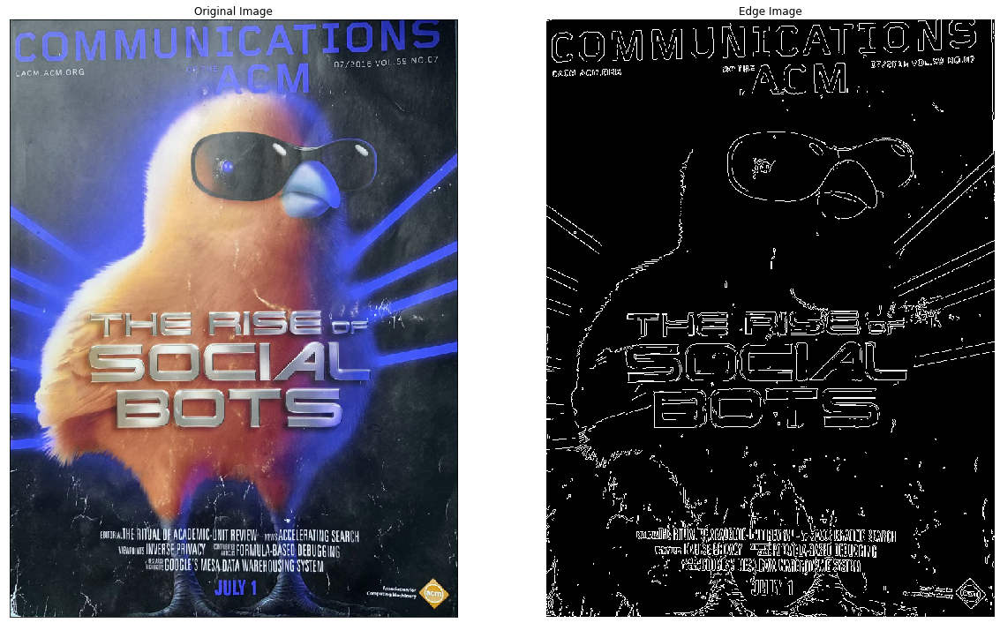

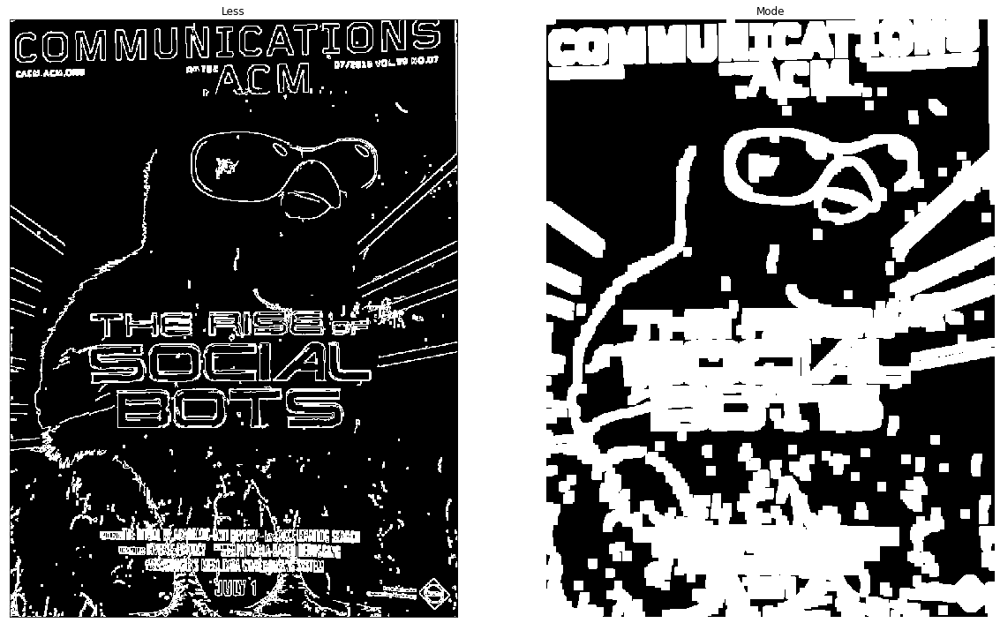

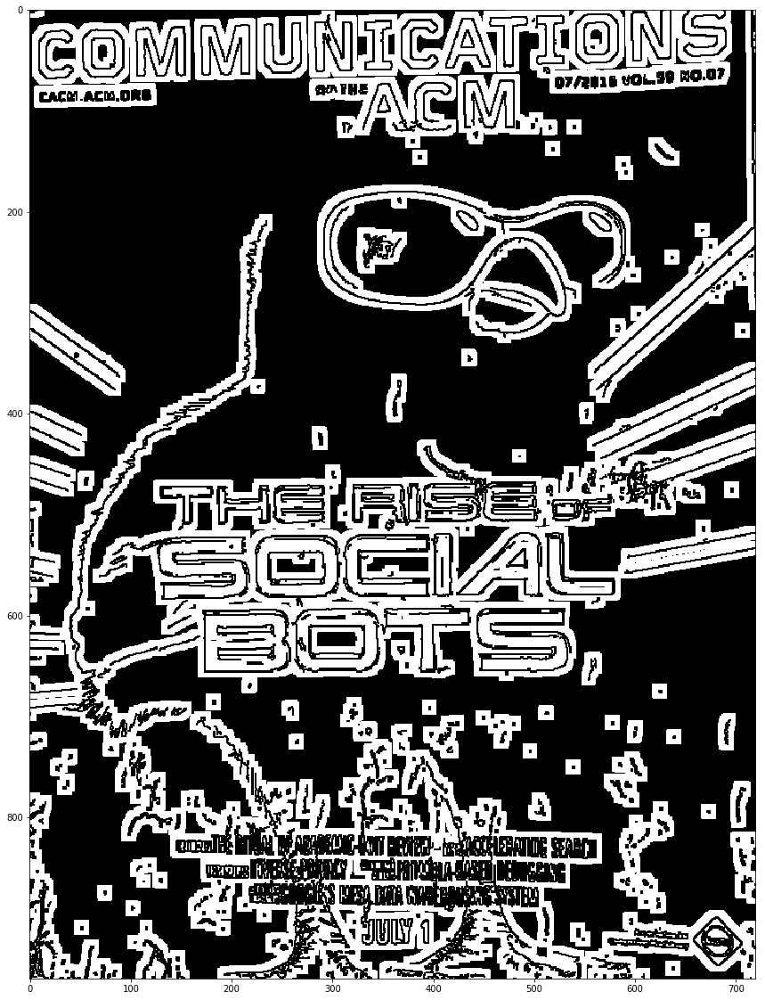

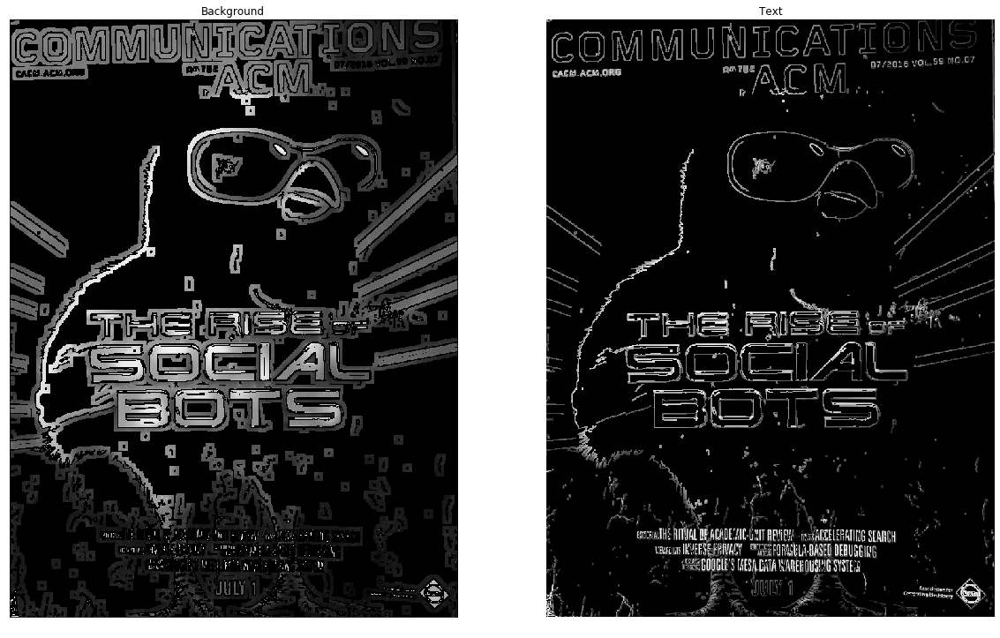

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text3.jpg


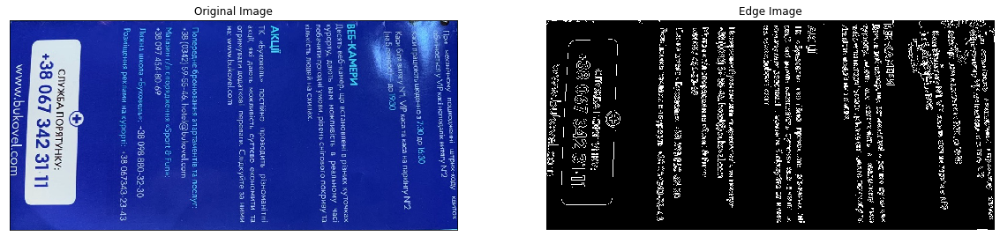

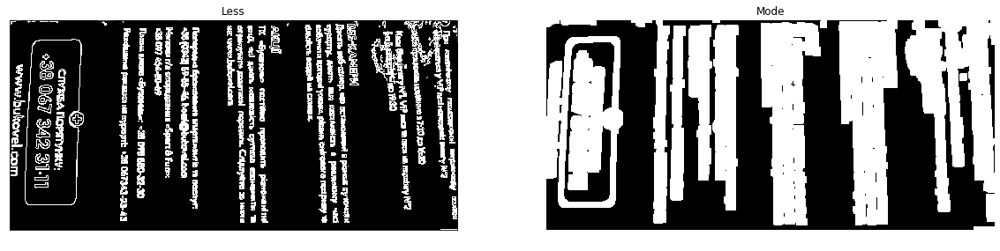

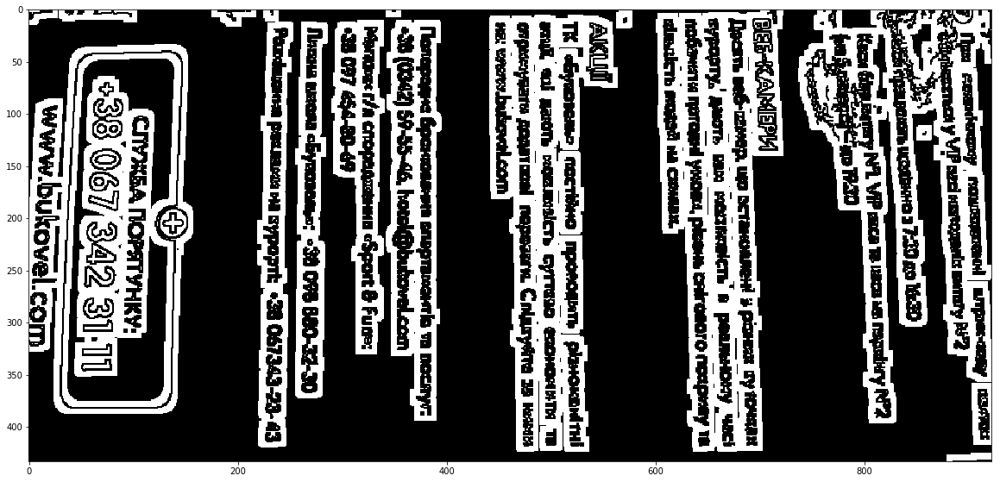

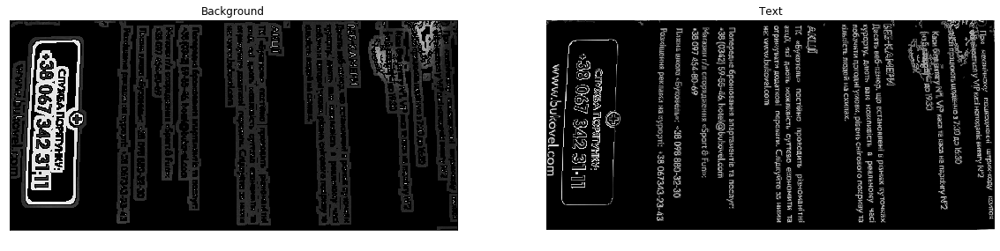

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text4.jpg


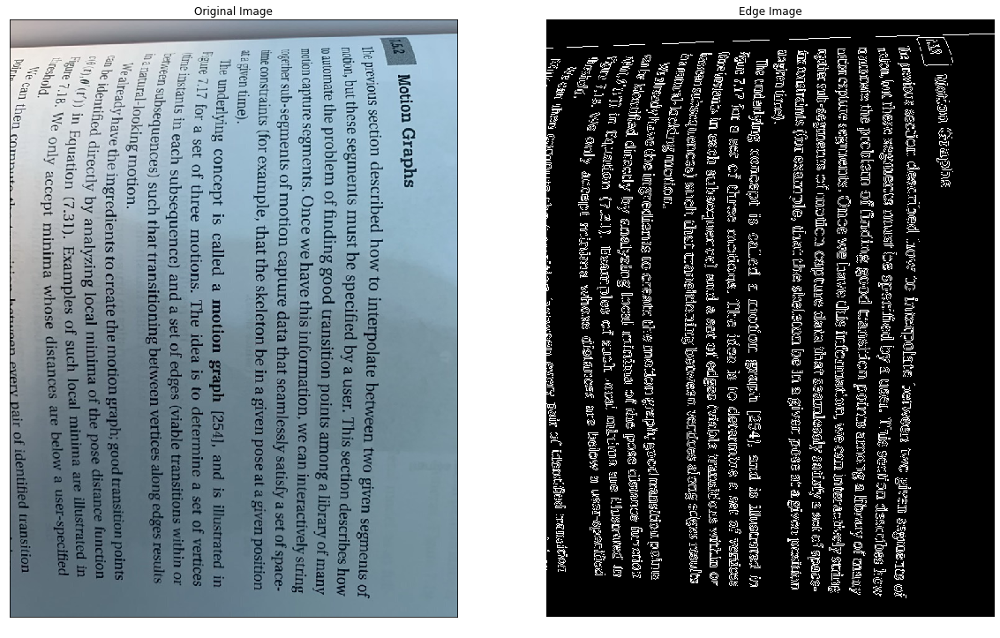

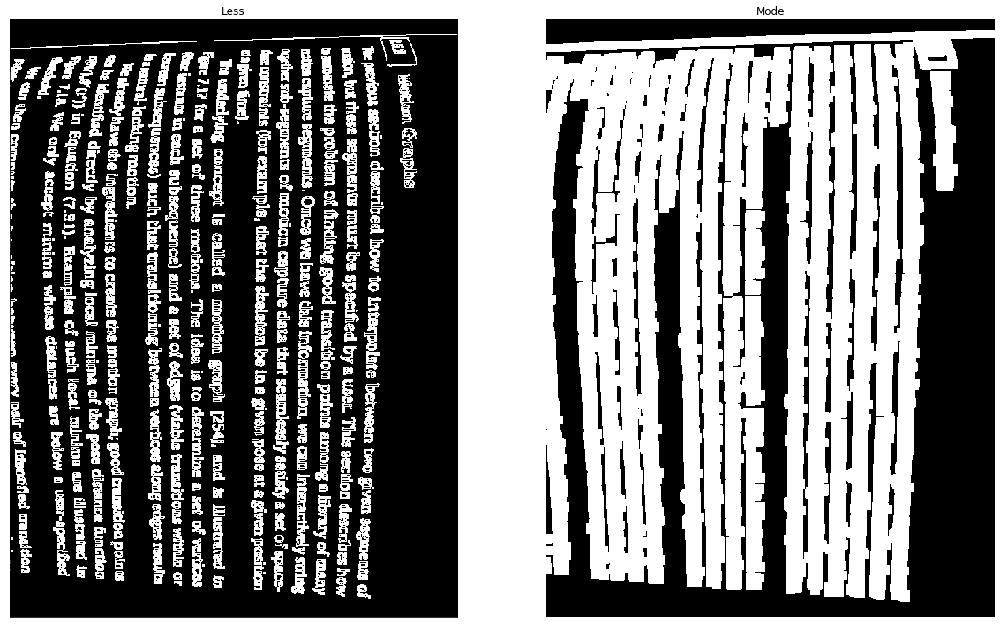

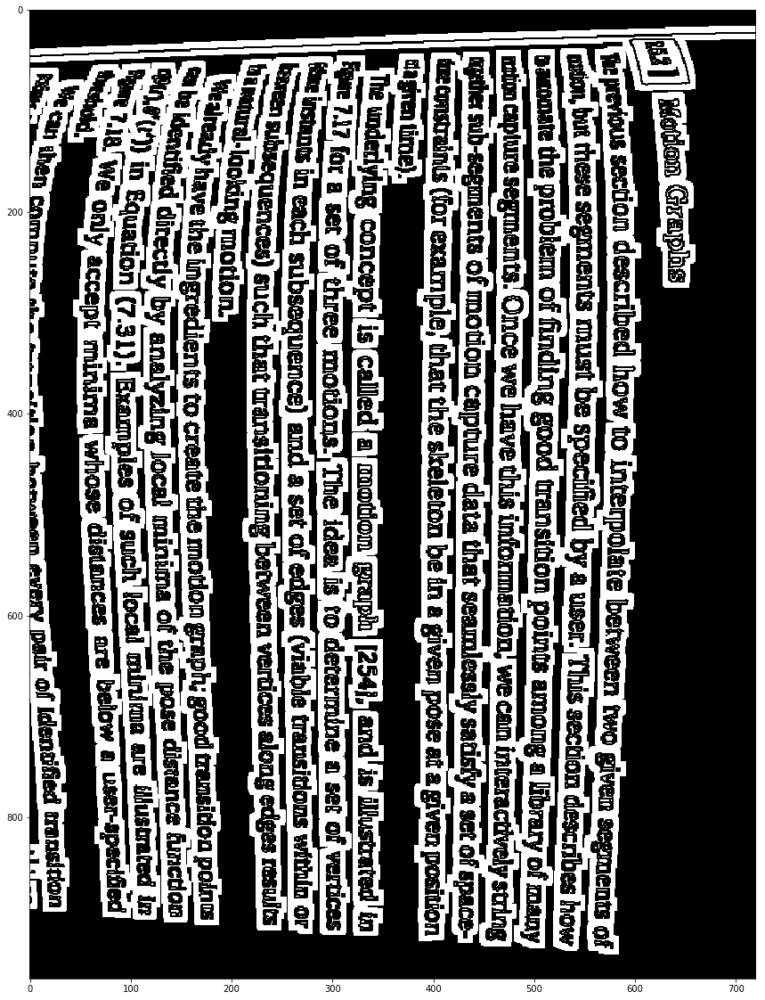

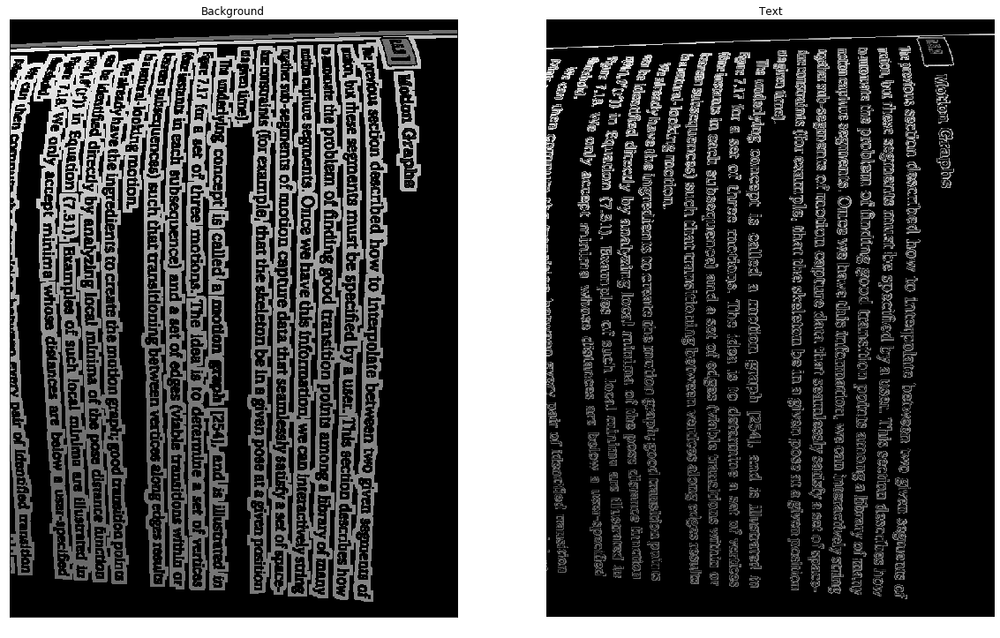

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text5.jpg


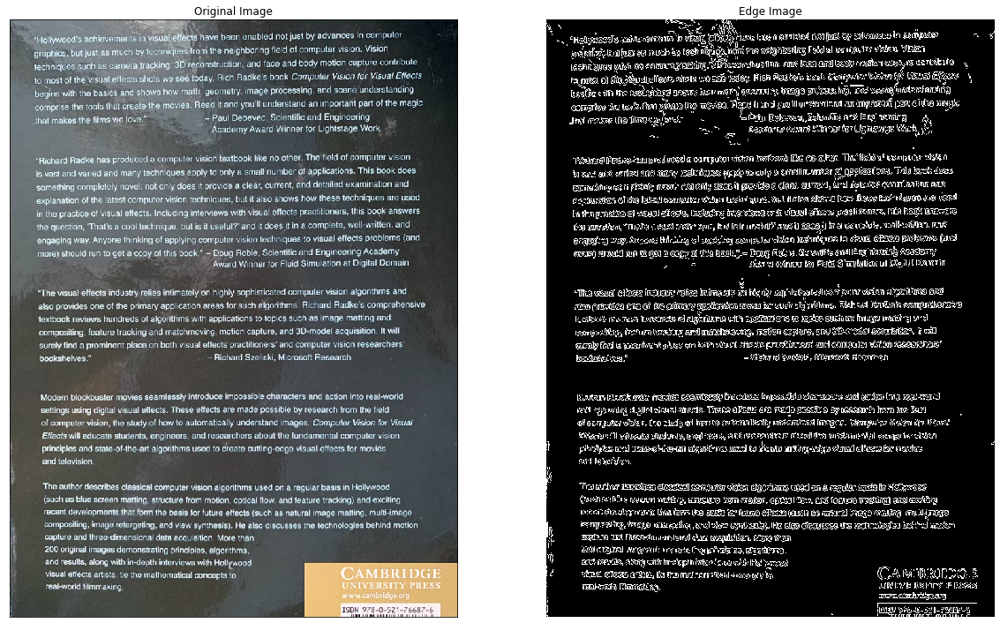

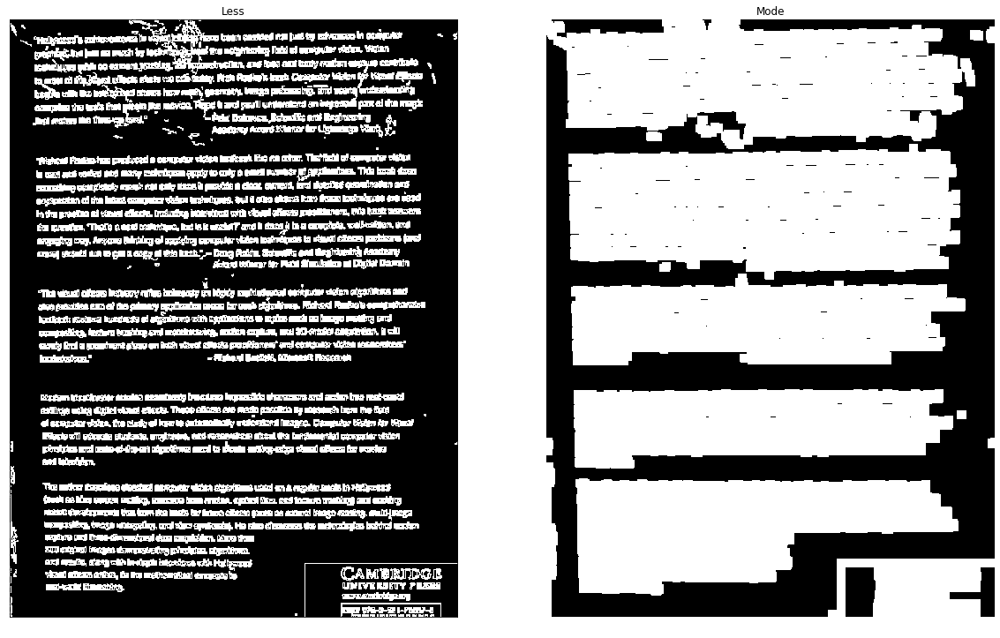

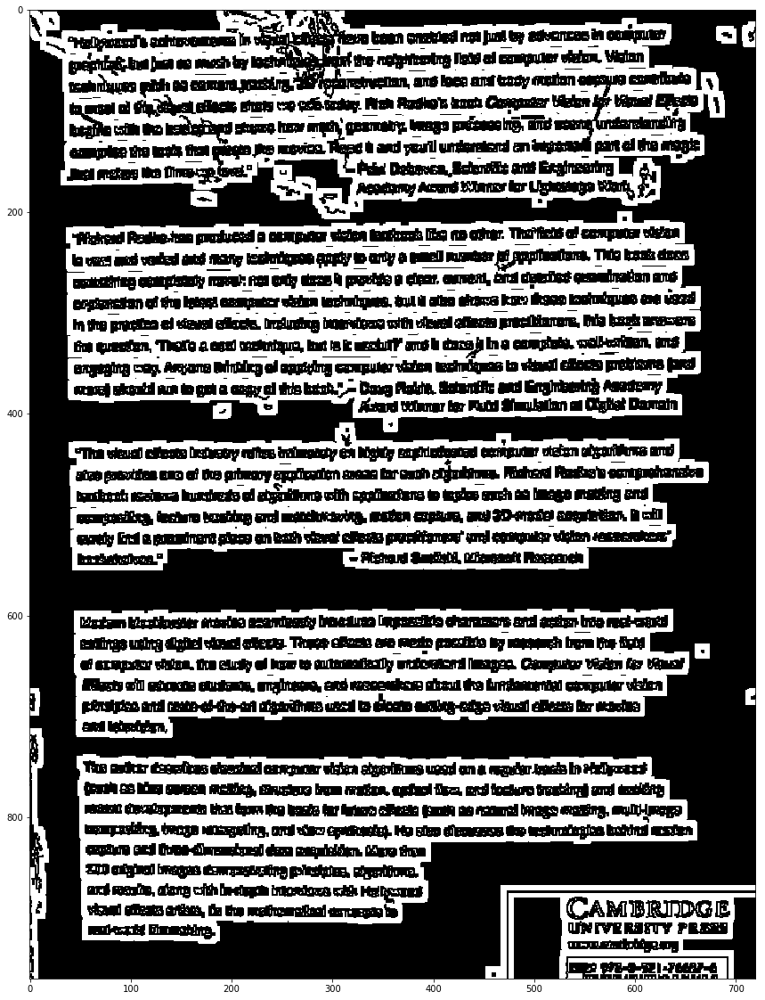

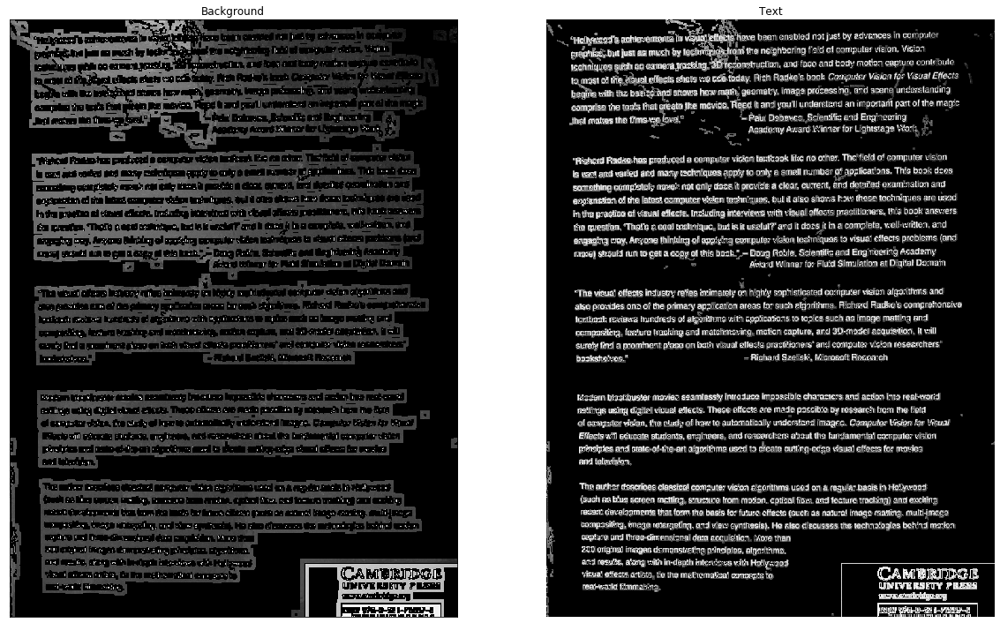

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text6.jpg


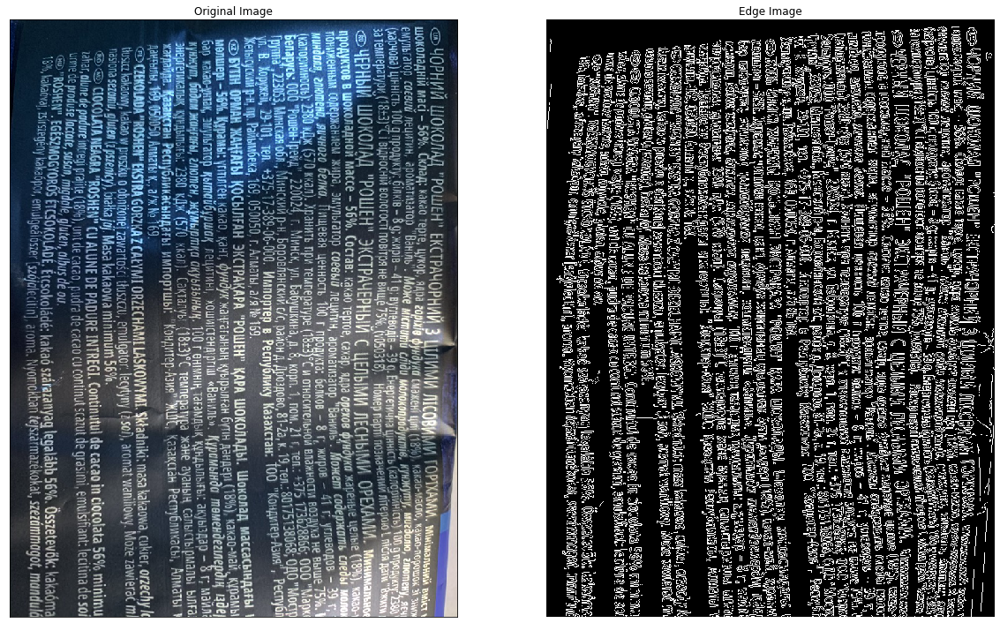

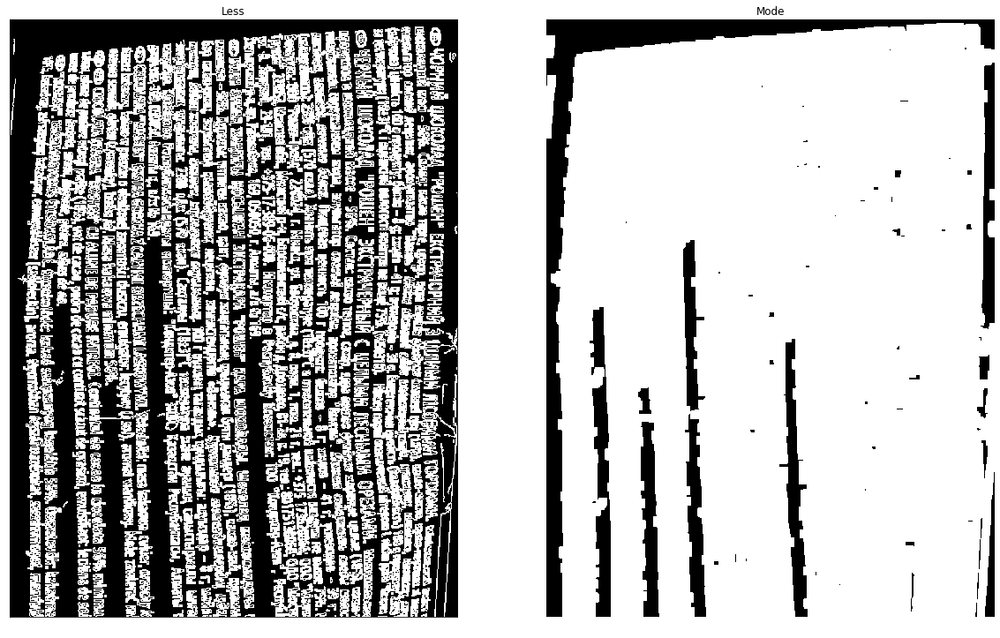

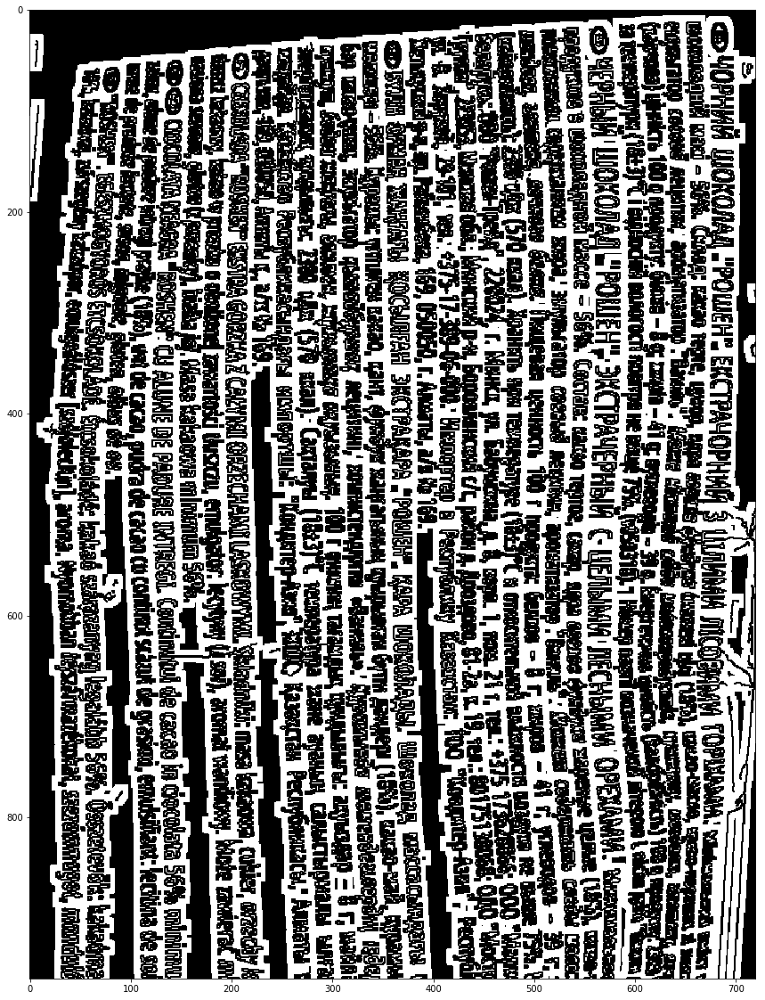

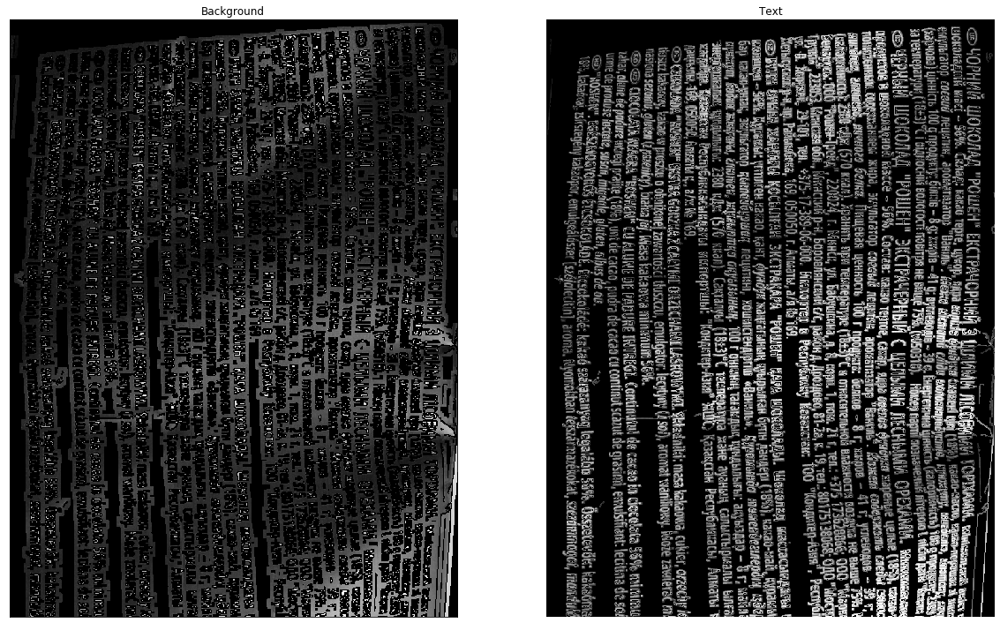

In [12]:
# https://docs.opencv.org/3.0-beta/doc/py_tutorials/py_imgproc/py_morphological_ops/py_morphological_ops.html

images = [
    'https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text1.jpg',
    'https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text2.jpg',
    'https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text3.jpg',
    'https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text4.jpg',
    'https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text5.jpg',
    'https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text6.jpg'
]

text_images = []

for url in images:
    img = url_to_image(url)
    img = rotate90(img)
    
    # blur = cv2.GaussianBlur(img,(5,5),0)
    # grayscaled = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    edges = cv2.Canny(img,100,200)

    plt.rcParams['figure.figsize'] = [20, 20]
    plt.subplot(121),plt.imshow(img,cmap = 'gray')
    plt.title('Original Image'), plt.xticks([]), plt.yticks([])
    plt.subplot(122),plt.imshow(edges,cmap = 'gray')
    plt.title('Edge Image'), plt.axis("off")
    plt.show()
    
#     kernel1 = np.ones((2,2),np.uint8)
#     erosion = cv2.erode(edges, kernel1, iterations = 1)
#     plt.imshow(erosion, cmap = 'gray')
#     plt.show()

    kernel1 = np.ones((2,2),np.uint8)
    dilation1 = cv2.dilate(edges, kernel1,iterations = 1)
    plt.imshow(dilation1, cmap = 'gray')
    #plt.show()

    kernel2 = np.ones((7,7),np.uint8)
    dilation = cv2.dilate(edges, kernel2,iterations = 2)
    plt.imshow(dilation, cmap = 'gray')
    #plt.show()
    
    plt.rcParams['figure.figsize'] = [20, 20]
    plt.subplot(121),plt.imshow(dilation1, cmap = 'gray')
    plt.title('Less'), plt.xticks([]), plt.yticks([])
    plt.subplot(122),plt.imshow(dilation, cmap = 'gray')
    plt.title('Mode'), plt.axis("off")
    plt.show()

    borders = cv2.bitwise_xor(dilation1, dilation, np.full_like(dilation1, 255))
    plt.imshow(borders, cmap = 'gray')
    plt.show()
    
    grayscaled = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    fg_background = cv2.bitwise_or(grayscaled, grayscaled, mask=borders)
    fg_text = cv2.bitwise_or(grayscaled, grayscaled, mask=dilation1)
    
    plt.rcParams['figure.figsize'] = [20, 20]
    plt.subplot(121),plt.imshow(fg_background, cmap = 'gray')
    plt.title('Background'), plt.xticks([]), plt.yticks([])
    plt.subplot(122),plt.imshow(fg_text, cmap = 'gray')
    plt.title('Text'), plt.axis("off")
    plt.show()
    
    text_images.append(fg_text)
    

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text1.jpg


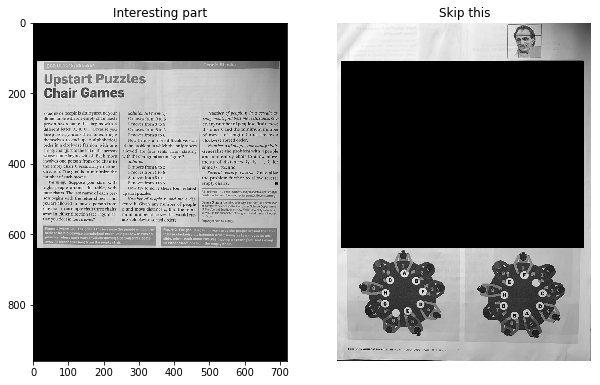

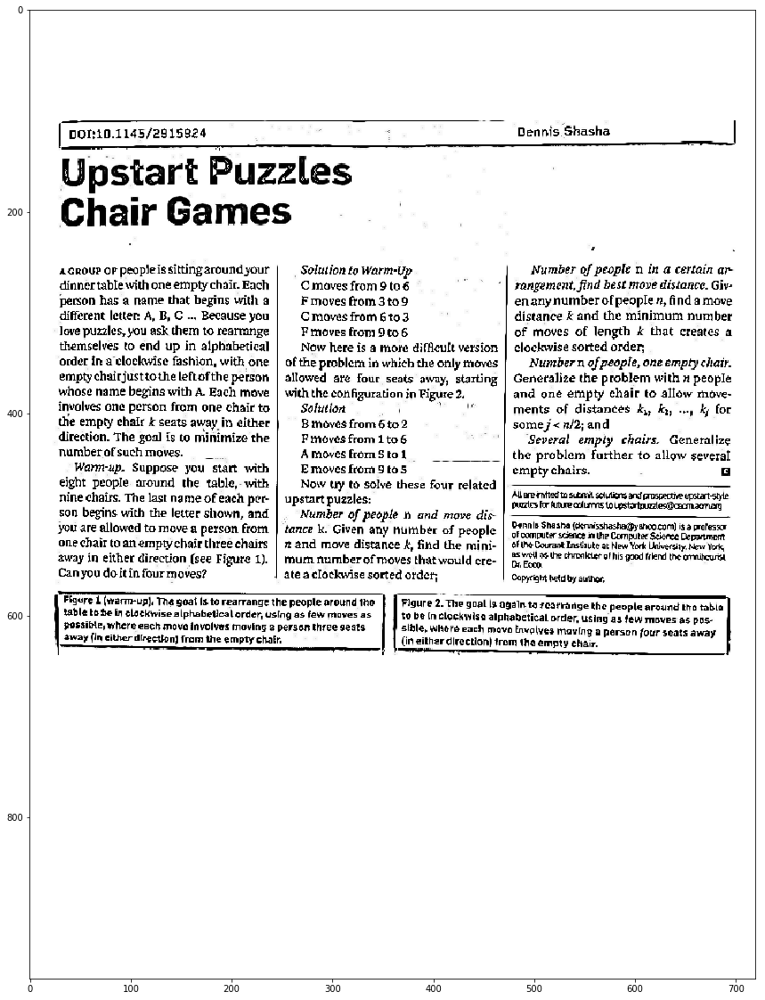

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text2.jpg


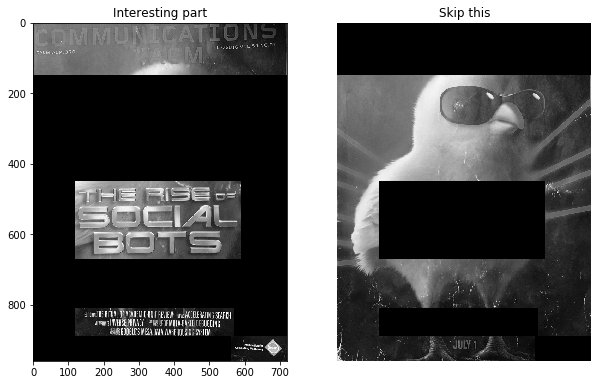

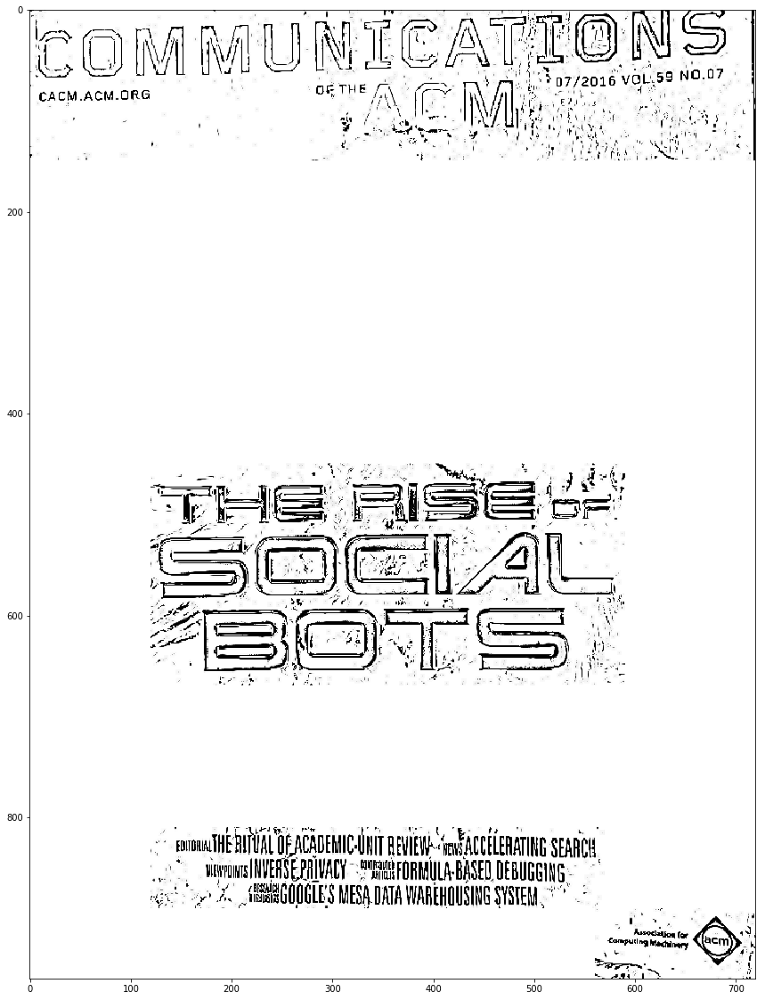

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text3.jpg


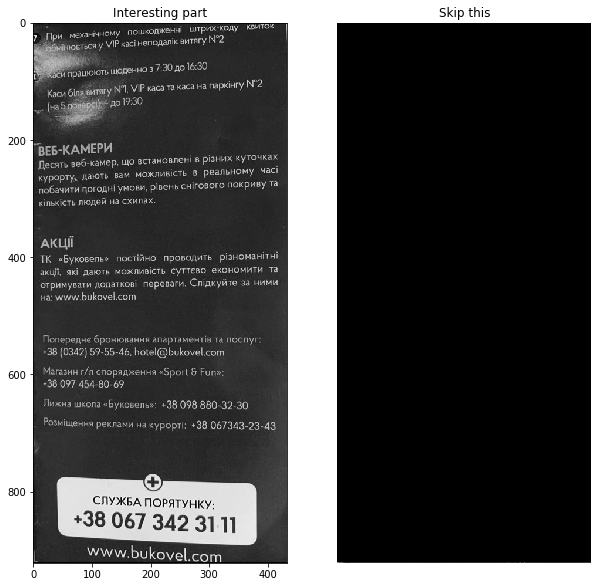

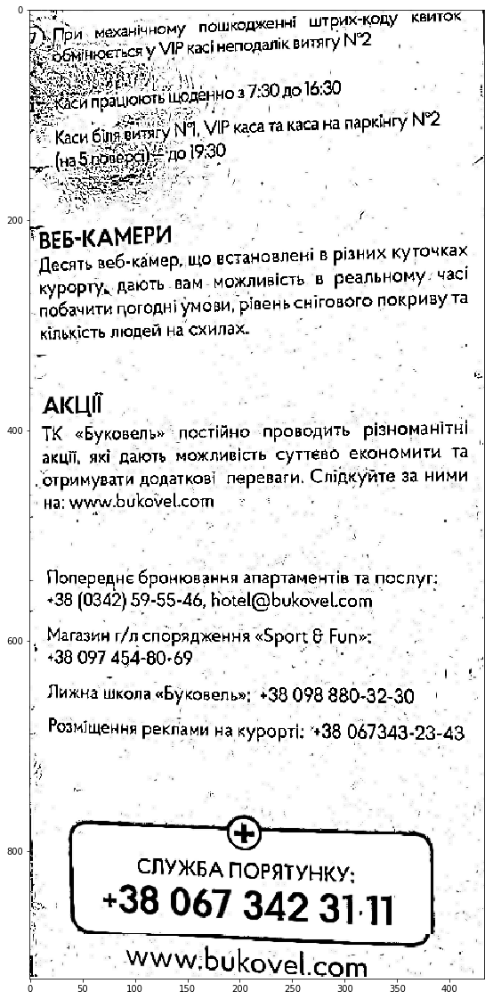

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text4.jpg


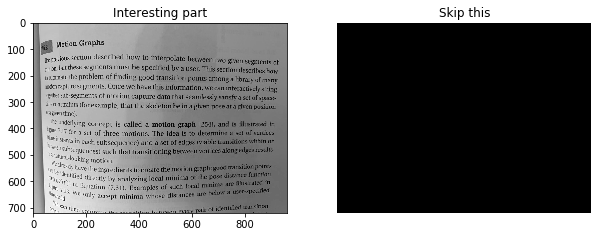

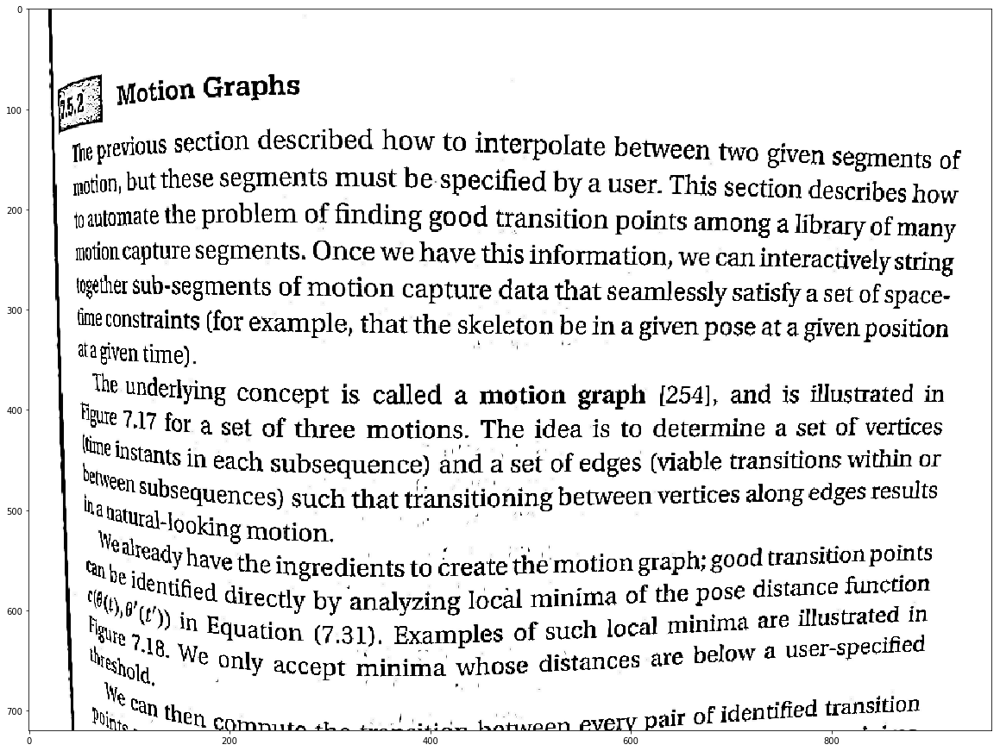

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text5.jpg


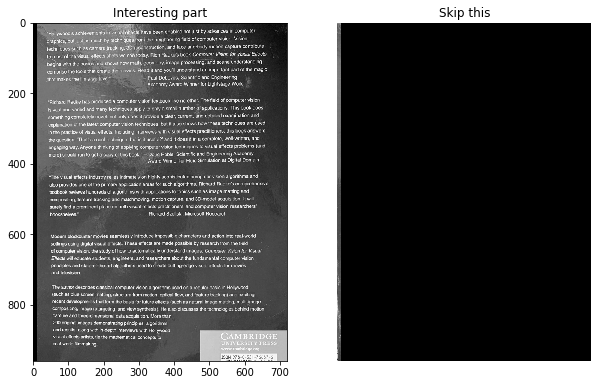

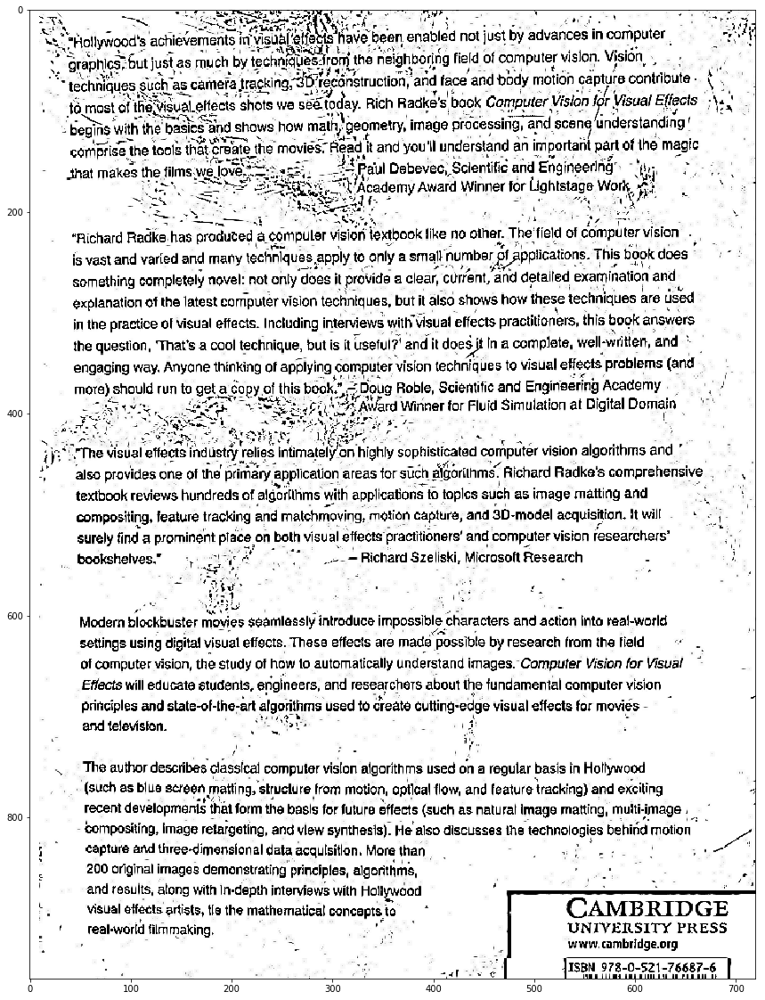

downloading https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text6.jpg


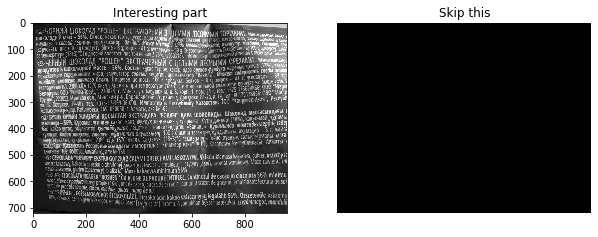

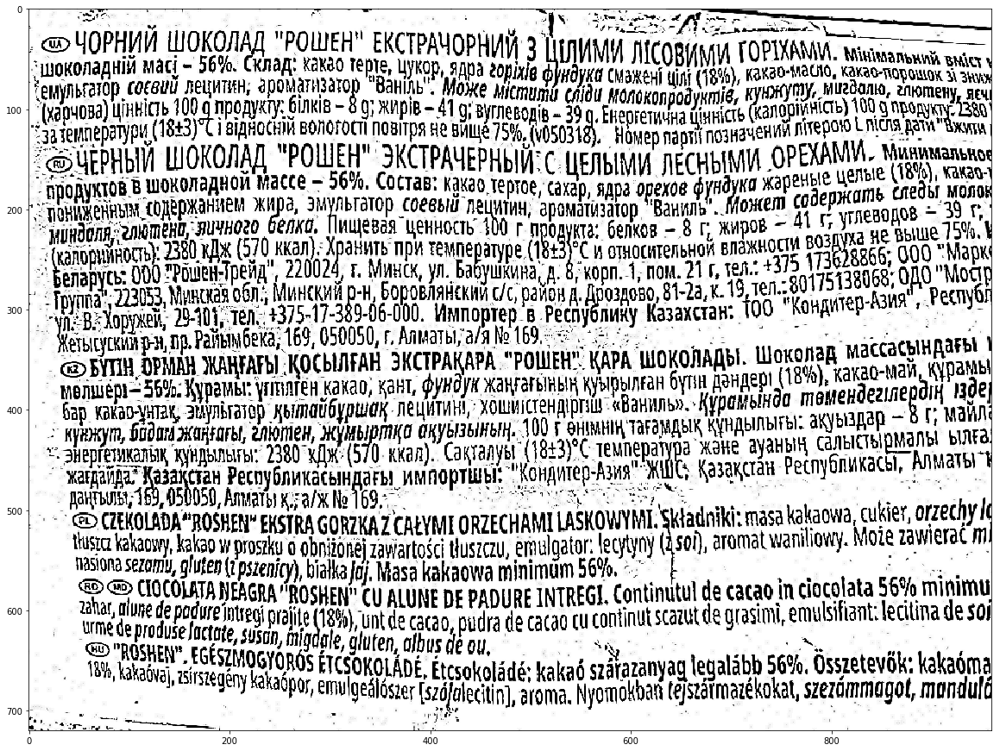

In [13]:
images = [
    {
    'url': 'https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text1.jpg',
    'rotate': True,
    'bboxes': [[110,140,10,700], [140,580,10,700], [580,640,10,700]]
    },
    {
    'url': 'https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text2.jpg',
    'rotate': True,
    'bboxes': [[0,150,0,920], [450,670,120,590], [810,890,120,570], [890,980,560,910]]
    },
    {'url': 'https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text3.jpg',
    'rotate': False,
    'bboxes': [[0,700,0,900], [700,880,0,900], [880,920,0,900]]
    },
    {'url': 'https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text4.jpg',
    'rotate': False,
    'bboxes': []
    },
    {'url': 'https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text5.jpg',
    'rotate': True,
    'bboxes': [[0,940,10,900], [940,1000,10,900]]
    },
    {'url': 'https://raw.githubusercontent.com/mdavydov/ComputerVisionCourse/master/tasks/text/text6.jpg',
    'rotate': False,
    'bboxes': []
    },
]

for image_obj in images:
    img = url_to_image(image_obj['url'])
    if image_obj['rotate']:
        img = rotate90(img) 
    grayscaled = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    
    mask = np.zeros((grayscaled.shape), dtype=np.uint8)
    
    # Fix when there is no bbox. Just use all the image
    if len(image_obj['bboxes']) == 0:
        image_obj['bboxes'] = [[0,grayscaled.shape[0],0,grayscaled.shape[1]]]
    
    # remove other parts except of bboxes
    for bbox in image_obj['bboxes']:
        mask[bbox[0]:bbox[1],bbox[2]:bbox[3]].fill(1)
    mask_inv = 1 - mask
        
    fg1 = cv2.bitwise_or(grayscaled, grayscaled, mask=mask)
    fg2 = cv2.bitwise_or(grayscaled, grayscaled, mask=mask_inv)
    plt.rcParams['figure.figsize'] = [10, 10]
    plt.subplot(121),plt.imshow(fg1,cmap = 'gray')
    plt.title('Interesting part')
    plt.subplot(122),plt.imshow(fg2,cmap = 'gray')
    plt.title('Skip this'), plt.axis("off")
    plt.show()
    
    # process
    background = np.full_like(grayscaled, 255)
    for bbox in image_obj['bboxes']:
        bbox_img = grayscaled[bbox[0]:bbox[1],bbox[2]:bbox[3]]
        # magic
        bbox_img_txt = simple_pipline(bbox_img)
        # update
        background[bbox[0]:bbox[1],bbox[2]:bbox[3]] = bbox_img_txt
        
    #fg = cv2.bitwise_or(grayscaled, grayscaled, mask=mask)
    plt.rcParams['figure.figsize'] = [20, 20]
    plt.imshow(background, cmap = 'gray')
    plt.show()